In [1]:
# Other elements
# https://fenicsproject.org/docs/dolfin/1.4.0/python/demo/index.html


Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.
Calling FFC just-in-time (JIT) compiler, this may take some time.


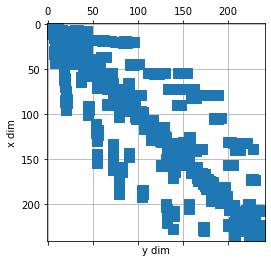

In [4]:
# 1/3

# Discontinuous Galerkin 

from mshr import *
from dolfin import *
from scipy.sparse import csr_matrix

import matplotlib.pyplot as plt
import scipy.sparse as sparse
import numpy as np

# # -----------
# # Libraries for stability analysis
# from __future__ import print_function
# from __future__ import division
# from IPython.display import clear_output
# from scipy.optimize import brenth
# from scipy.optimize import fsolve
# from scipy.linalg import eigvals
# from scipy.linalg import eig
# from scipy.sparse.linalg import eigs
# from scipy.interpolate import interp1d
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter, AutoMinorLocator)
# from matplotlib import rc
# import matplotlib
# import scipy.signal
# from math import pi
# import time
# import math
# %matplotlib inline
# -----------

# OPERATORS
zcross = lambda i: as_vector((-i[1],i[0]))

# BASIN & MESH
length = 5.0
width  = 5.0
resolution = 3
geometry  = Rectangle(Point(0.0, 0.0), Point(width, length))
mesh = generate_mesh(geometry, resolution)
plot(mesh);



# 2/3

# FUNCTION & VECTOR SPACES
DG = VectorElement("DG", mesh.ufl_cell(), 1)
CG = FiniteElement("CG", mesh.ufl_cell(), 2)
G = FunctionSpace(mesh, MixedElement((DG, CG)))

# TRIAL/TEST FUNCTIONS
(u, eta) = TrialFunctions(G)
(v, lmbda) = TestFunctions(G)

# EIGENVALUE SOLs
eigenvalues_real = []
eigenvalues_imag = []

# VARIABLES
F    = Constant("1.0")
Ro   = Constant("1.0")
Fcor = Constant("0.0")
#Fcor = Constant("1.0")

# SET-UP EQUATION
a = inner(v, Fcor*zcross(u))*dx \
    + inner(v, grad(eta))*dx \
    - inner(u, grad(lmbda))*dx

m = Ro*inner(v, u)*dx + Ro*F*lmbda*eta*dx

A = PETScMatrix()
assemble(a, tensor = A)
M = PETScMatrix()
assemble(m, tensor = M)

A_mat = as_backend_type(A).mat()

A_sparray = csr_matrix(A_mat.getValuesCSR()[::-1], shape = A_mat.size)

# print(A_sparray)
plt.spy(A_sparray)
plt.rcParams ['figure.figsize'] = [12, 8]
plt.grid (True, which = "both")
plt.xlabel("y dim")
plt.ylabel("x dim")

plt.show()

In [ ]:
# 2/3

# Create eigensolver
# eig_num    = 100
eigensolver = SLEPcEigenSolver(A, M)

# # -----
# # Number of eigenvalues to be extracted

# # Scipy Eigen package
# eig_vals, eig_vecs = sc.sparse.linalg.eigsh(sc_Kt_sld, k=eign_num, which='SA', mode='buckling')
# # -----

# eigensolver.parameters["spectrum"] = "target imaginary"
# eigensolver.parameters["spectral_transform"] = "shift-and-invert"
# eigensolver.parameters["spectral_shift"] = 1.0

# Compute all eigenvalues of A x = \lambda x
print("Computing eigenvalues. This can take a minute.")
eigensolver.solve()
# eigensolver.solve(n)

listreal = []
listimag = []

# Computing the eigenvalues
for i in range(eigensolver.get_number_converged()):
    
    print ("i = ", i)
    
    r, c, rx, cx = eigensolver.get_eigenpair(i)
    
    listreal.append (r)
    print ("real      =", r)
    
    listimag.append (c)
    print ("imaginary =", c)

# Extract largest (first) eigenpair
r, c, rx, cx = eigensolver.get_eigenpair(0)
print("")

print("Largest REAL eigenvalue: ", r)
print("Largest IMAGINARY eigenvalue: ", c)


In [ ]:
# 3/3

import matplotlib

eigenvalues_real.append(r)
eigenvalues_imag.append(c)

# DEFN FUNCTION SPACES
eigenmodes_real = Function(G, rx)
eigenmodes_imag = Function(G, cx)

# ur, etar = eigenmodes_real.split()
# ui, etai = eigenmodes_imag.split()

# # LIST EIGENVALUES
# print ("Real Eigenfrequencies:"), eigenvalues_real
# print ("Imaginary Eigenfrequencies:"), eigenvalues_imag

# SAVE LAST REAL
File("eigenvalues_test/eigenmodes_real.pvd") << eigenmodes_real

# SAVE LAST IMAGINARY
File("eigenvalues_test/.pvd") << eigenmodes_imag

# TUTORIALS
# https://fenicsproject.org/qa/13796/formulating-an-eigenvalue-problem/
# https://fenicsproject.org/qa/8680/solving-generalized-eigenvalues-finite-element-stiff-matrix/

# Characteristics for plots
liststyles       = ["--", "-", "-.", "."]
listcolor        = ["k", "g", "b", "r", "none"]
listmarkers      = ["s", "o", "^", ">", "<", "p"]

# Plot eigenspectra
fig, ax = plt.subplots ()
area = 50
            
ax.scatter (listreal, listimag, s = area, marker = listmarkers [0], color = listcolor [4], edgecolors = listcolor [0], linewidths = 1.5, alpha = 0.5, label = 'mesh resolution = ' + str(resolution))
ax.set_xscale ('symlog', linthreshx = 1e-17)
# ax.set_yscale ('symlog')

ax.xaxis.set_minor_locator(MultipleLocator(10000))

plt.rcParams ['figure.figsize'] = [12, 8]
leg1 = ax.legend (loc = 'upper right', frameon = True, fontsize = 14);
plt.grid (True, which = "both")
plt.xlabel ('Re $[\omega]$ [1/s]', fontsize = 18)
plt.ylabel ('Im $[\omega]$ [1/s]', fontsize = 16)
        
matplotlib.rc ('xtick', labelsize = 18)     
matplotlib.rc ('ytick', labelsize = 18)

plt.ylim (( - 10.5 , 10.5))
plt.xlim (( - 1e-11, 1e-11))

plt.show ()

In [ ]:
#! /usr/bin/env python
#
from fenics import *

def dg_advection_diffusion ( my_grid, my_degree ):

#*****************************************************************************80
#
## dg_advection_diffusion : discontinuous Galerkin method, advection-diffusion.
#
#  Discussion:
#
#    u grad phi - kappa del phi = f
#
#    Dirichlet boundary on right side with value sin(5*pi*y).
#    Convecting velocity (-1, -0.4).
#
#  Licensing:
#
#    This code is distributed under the GNU LGPL license.
#
#  Modified:
#
#    11 January 2019
#
#  Author:
#
#    John Burkardt
#
#  Parameters:
#
  import matplotlib.pyplot as plt
#
#  Report input.
#
  print ( '' )
  print ( '  Case of %d x %d mesh' % ( my_grid, my_grid ) )
  print ( '  Approximation degree %d:' % ( my_degree ) )
#
#  Mesh the unit square.
#
  my_mesh = UnitSquareMesh ( my_grid, my_grid, 'right/left' )
#
#  Set function spaces.
#
  V_dg = FunctionSpace ( my_mesh, 'DG',  my_degree )
  V_cg = FunctionSpace ( my_mesh, 'CG',  my_degree )
  V_u  = VectorFunctionSpace ( my_mesh, 'CG', my_degree + 1 )
#
#  Create velocity function.
#
  u = interpolate ( Constant ( ( "-1.0", "-0.4" ) ), V_u )
#
#  Trial and test functions.
#
  phi = TrialFunction ( V_dg )
  v   = TestFunction ( V_dg )
#
#  Diffusivity.
#
  kappa = Constant ( 0.0 )
#
#  Source term.
#
  f = Constant ( 0.0 )
#
#  Penalty term.
#
  alpha = Constant ( 5.0 )
#
#  Mesh-related functions.
#
  n = FacetNormal ( my_mesh )
  h = CellDiameter ( my_mesh )
  h_avg = ( h('+') + h('-') ) / 2.0
#
#  (dot(v,n) + |dot(v,n)| ) / 2.0
#
  un = ( dot ( u, n ) + abs ( dot ( u, n ) ) ) / 2.0
#
#  Bilinear form.
#
  a_int = dot ( grad ( v ), kappa * grad ( phi ) - u * phi ) * dx

  a_fac = kappa('+') * ( alpha('+') / h('+') ) * dot ( jump ( v, n ), jump ( phi, n ) ) * dS \
        - kappa('+') * dot ( avg ( grad ( v ) ), jump ( phi, n ) ) * dS \
        - kappa('+') * dot ( jump ( v, n ), avg ( grad ( phi ) ) ) * dS

  a_vel = dot ( jump ( v ), un('+') * phi('+') - un('-') * phi('-') ) * dS \
        + dot ( v, un * phi ) * ds

  a = a_int + a_fac + a_vel
#
#  Linear form.
#
  L = v * f * dx
#
#  Set up boundary condition, applying strong BCs.
#
  class DirichletBoundary ( SubDomain ):
    def inside ( self, x, on_boundary ):
      return abs ( x[0] - 1.0 ) < DOLFIN_EPS and on_boundary

  g = Expression ( "sin ( pi * 5.0 * x[1] )", degree = 2 )
  bc = DirichletBC ( V_dg, g, DirichletBoundary(), "geometric" )
#
#  Solution function.
#
  phi_h = Function ( V_dg )
#
#  Assemble and apply boundary conditions.
#
  A = assemble ( a )
  b = assemble ( L )
  bc.apply ( A, b )
#
#  Solve system.
#
  solve ( A, phi_h.vector(), b )
#
#  Project solution to a continuous function space.
#
  up = project ( phi_h, V = V_cg )
#
#  Plot the solution.
#
  plot ( up, title = 'up' )
  filename = 'up.png'
  plt.savefig ( filename )
  print ( '  Graphics saved as "%s"' % ( filename ) )
  plt.close ( )
#
#  Terminate.
#
  return

def dg_advection_diffusion_test ( ):

#*****************************************************************************80
#
## dg_advection_diffusion_test tests dg_advection_diffusion.
#
#  Licensing:
#
#    This code is distributed under the GNU LGPL license.
#
#  Modified:
#
#    11 January 2019
#
#  Author:
#
#    John Burkardt
#
  import time

  print ( time.ctime ( time.time() ) )
  print ( '' )
  print ( 'dg_advection_diffusion_test:' )
  print ( '  FENICS/Python version' )
  print ( '  Discontinuous Galerkin method for advection/diffusion equation.' )
#
#  Report level = only warnings or higher.
#
  level = 30
  set_log_level ( level )

  my_grid = 64
  my_degree = 1
  dg_advection_diffusion ( my_grid, my_degree )
#
#  Terminate.
#
  print ( '' )
  print ( 'dg_advection_diffusiontest:' );
  print ( '  Normal end of execution.' )
  print ( '' )
  print ( time.ctime ( time.time() ) )

if ( __name__ == '__main__' ):

  dg_advection_diffusion_test ( )
#! /usr/bin/env python
#
from fenics import *

def dg_advection_diffusion ( my_grid, my_degree ):

#*****************************************************************************80
#
## dg_advection_diffusion : discontinuous Galerkin method, advection-diffusion.
#
#  Discussion:
#
#    u grad phi - kappa del phi = f
#
#    Dirichlet boundary on right side with value sin(5*pi*y).
#    Convecting velocity (-1, -0.4).
#
#  Licensing:
#
#    This code is distributed under the GNU LGPL license.
#
#  Modified:
#
#    11 January 2019
#
#  Author:
#
#    John Burkardt
#
#  Parameters:
#
  import matplotlib.pyplot as plt
#
#  Report input.
#
  print ( '' )
  print ( '  Case of %d x %d mesh' % ( my_grid, my_grid ) )
  print ( '  Approximation degree %d:' % ( my_degree ) )
#
#  Mesh the unit square.
#
  my_mesh = UnitSquareMesh ( my_grid, my_grid, 'right/left' )
#
#  Set function spaces.
#
  V_dg = FunctionSpace ( my_mesh, 'DG',  my_degree )
  V_cg = FunctionSpace ( my_mesh, 'CG',  my_degree )
  V_u  = VectorFunctionSpace ( my_mesh, 'CG', my_degree + 1 )
#
#  Create velocity function.
#
  u = interpolate ( Constant ( ( "-1.0", "-0.4" ) ), V_u )
#
#  Trial and test functions.
#
  phi = TrialFunction ( V_dg )
  v   = TestFunction ( V_dg )
#
#  Diffusivity.
#
  kappa = Constant ( 0.0 )
#
#  Source term.
#
  f = Constant ( 0.0 )
#
#  Penalty term.
#
  alpha = Constant ( 5.0 )
#
#  Mesh-related functions.
#
  n = FacetNormal ( my_mesh )
  h = CellDiameter ( my_mesh )
  h_avg = ( h('+') + h('-') ) / 2.0
#
#  (dot(v,n) + |dot(v,n)| ) / 2.0
#
  un = ( dot ( u, n ) + abs ( dot ( u, n ) ) ) / 2.0
#
#  Bilinear form.
#
  a_int = dot ( grad ( v ), kappa * grad ( phi ) - u * phi ) * dx

  a_fac = kappa('+') * ( alpha('+') / h('+') ) * dot ( jump ( v, n ), jump ( phi, n ) ) * dS \
        - kappa('+') * dot ( avg ( grad ( v ) ), jump ( phi, n ) ) * dS \
        - kappa('+') * dot ( jump ( v, n ), avg ( grad ( phi ) ) ) * dS

  a_vel = dot ( jump ( v ), un('+') * phi('+') - un('-') * phi('-') ) * dS \
        + dot ( v, un * phi ) * ds

  a = a_int + a_fac + a_vel
#
#  Linear form.
#
  L = v * f * dx
#
#  Set up boundary condition, applying strong BCs.
#
  class DirichletBoundary ( SubDomain ):
    def inside ( self, x, on_boundary ):
      return abs ( x[0] - 1.0 ) < DOLFIN_EPS and on_boundary

  g = Expression ( "sin ( pi * 5.0 * x[1] )", degree = 2 )
  bc = DirichletBC ( V_dg, g, DirichletBoundary(), "geometric" )
#
#  Solution function.
#
  phi_h = Function ( V_dg )
#
#  Assemble and apply boundary conditions.
#
  A = assemble ( a )
  b = assemble ( L )
  bc.apply ( A, b )
#
#  Solve system.
#
  solve ( A, phi_h.vector(), b )
#
#  Project solution to a continuous function space.
#
  up = project ( phi_h, V = V_cg )
#
#  Plot the solution.
#
  plot ( up, title = 'up' )
  filename = 'up.png'
  plt.savefig ( filename )
  print ( '  Graphics saved as "%s"' % ( filename ) )
  plt.close ( )
#
#  Terminate.
#
  return

def dg_advection_diffusion_test ( ):

#*****************************************************************************80
#
## dg_advection_diffusion_test tests dg_advection_diffusion.
#
#  Licensing:
#
#    This code is distributed under the GNU LGPL license.
#
#  Modified:
#
#    11 January 2019
#
#  Author:
#
#    John Burkardt
#
  import time

  print ( time.ctime ( time.time() ) )
  print ( '' )
  print ( 'dg_advection_diffusion_test:' )
  print ( '  FENICS/Python version' )
  print ( '  Discontinuous Galerkin method for advection/diffusion equation.' )
#
#  Report level = only warnings or higher.
#
  level = 30
  set_log_level ( level )

  my_grid = 64
  my_degree = 1
  dg_advection_diffusion ( my_grid, my_degree )
#
#  Terminate.
#
  print ( '' )
  print ( 'dg_advection_diffusiontest:' );
  print ( '  Normal end of execution.' )
  print ( '' )
  print ( time.ctime ( time.time() ) )

if ( __name__ == '__main__' ):

  dg_advection_diffusion_test ( )


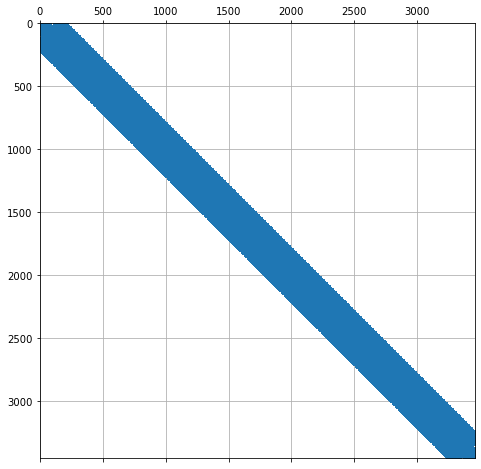

Solution vector norm (0): 63.72047012989159


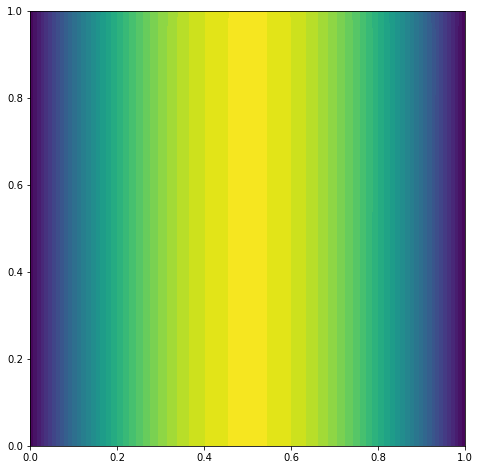

In [11]:
# DG 2D Poisson with constant f,g,u0

"""This demo program solves Poisson's equation 2D

    - div grad u(x, y) = f(x, y)

on the unit square with source f given by

    f(x, y) = -100*exp(-((x - 0.5)^2 + (y - 0.5)^2)/0.02)

and boundary conditions given by

    u(x, y)     = u0 on x = 0 and x = 1
    du/dn(x, y) = g  on y = 0 and y = 1

where

    u0 = x + 0.25*sin(2*pi*x)
    g = (y - 0.5)**2

using a discontinuous Galerkin formulation (interior penalty method).
"""

from dolfin import *
from scipy.sparse import csr_matrix

# FIXME: Make mesh ghosted
parameters["ghost_mode"] = "shared_facet"

# Define class marking Dirichlet boundary (x = 0 or x = 1)
class DirichletBoundary(SubDomain):
  def inside(self, x, on_boundary):
    return on_boundary and near(x[0]*(1 - x[0]), 0)

# Create mesh and define function space
mesh = UnitSquareMesh(24, 24)

element = FiniteElement("Discontinuous Lagrange", "triangle", degree=1)
V       = FunctionSpace (mesh, element)

# Define test and trial functions
v = TestFunction(V)
du = TrialFunction(V)
u = Function(V)

# Define normal vector and mesh size
n = FacetNormal(mesh)
h = CellDiameter(mesh)
h_avg = (h('+') + h('-'))/2

# Define the source term f, Dirichlet term u0
f = Constant(1)
u0 = Constant(1)

# Mark facets of the mesh
boundaries = MeshFunction('size_t', mesh, mesh.topology().dim()-1, 0)
DirichletBoundary().mark(boundaries, 1)

# Define outer surface measure aware of Dirichlet and Neumann boundaries
ds = Measure('ds', domain = mesh, subdomain_data = boundaries)

# Define parameters
alpha = 4.0
gamma = 8.0

# Define variational problem
a = dot(grad(v), grad(u))*dx \
   - dot(avg(grad(v)), jump(u, n))*dS \
   - dot(jump(v, n), avg(grad(u)))*dS \
   + alpha/h_avg*dot(jump(v, n), jump(u, n))*dS \
   - dot(grad(v), u*n)*ds(1) \
   - dot(v*n, grad(u))*ds(1) \
   + (gamma/h)*v*u*ds(1)
   
L = v*f*dx - u0*dot(grad(v), n)*ds(1) + (gamma/h)*u0*v*ds(1)

# Compute solution
# u = Function(V)
dF = derivative (a - L, u, du)

A = PETScMatrix()
assemble(dF, tensor = A)
A_mat = as_backend_type(A).mat()
A_sparray = csr_matrix(A_mat.getValuesCSR()[::-1], shape = A_mat.size)

plt.spy(A_sparray)
plt.rcParams ['figure.figsize'] = [12, 8]
plt.grid (True, which = "both")
plt.show()

problem = NonlinearVariationalProblem (a - L, u, J = dF)
solver  = NonlinearVariationalSolver (problem)
solver.solve ()  

# solve(a == L, u)
print("Solution vector norm (0): {!r}".format(u.vector().norm("l2")))
plot (u)


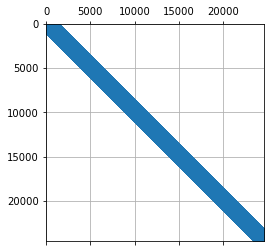

Solution vector norm (0): 98.9852252646654


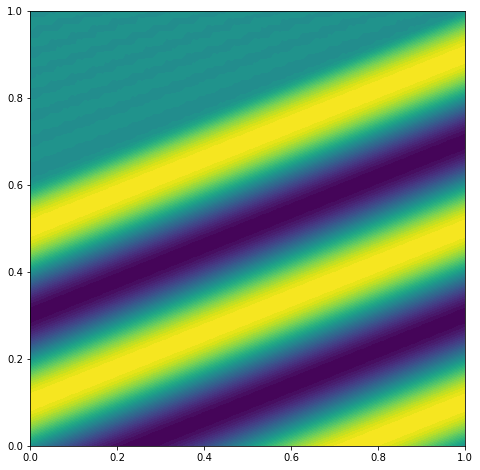

In [1]:
""" Steady state advection-diffusion equation,
discontinuous formulation using full upwinding.
"""

# u phi_x - kappa phi_xx = f
# Dirichlet boundary on right side with value sin(5*pi*y).
# Convecting velocity (-1, -0.4).

from dolfin import *
import matplotlib.pyplot as plt
from scipy.sparse import csr_matrix

# FIXME: Make mesh ghosted
parameters["ghost_mode"] = "shared_facet"

class DirichletBoundary(SubDomain):
    def inside(self, x, on_boundary):
        return abs(x[0] - 1.0) < DOLFIN_EPS and on_boundary

# Load mesh
mesh = Mesh("unitsquare_64_64.xml.gz")

# Defining the function spaces
V_dg = FunctionSpace(mesh, "DG", 1)
# V_cg = FunctionSpace(mesh, "CG", 1)
V_u  = VectorFunctionSpace(mesh, "CG", 2)

# Create velocity Function
u = Function(V_u, "unitsquare_64_64_velocity.xml.gz")

# Test and trial functions
v   = TestFunction(V_dg)
dphi = TrialFunction(V_dg)
phi = Function(V_dg)

# Diffusivity
kappa = Constant(0.0)

# Source term
f = Constant(0.0)

# Penalty term
alpha = Constant(10.0)

# Mesh-related functions
n = FacetNormal(mesh)
h = CellDiameter (mesh)
h_avg = (h('+') + h('-'))/2 #avg(h,h)

# ( dot(v, n) + |dot(v, n)| )/2.0
un = (dot(u, n) + abs(dot(u, n)))/2.0

# Bilinear form
a_int = dot(grad(v), kappa*grad(phi) - u*phi)*dx

a_fac = kappa*(alpha/h('+'))*dot(jump(v, n), jump(phi, n))*dS \
      - kappa*dot(avg(grad(v)), jump(phi, n))*dS \
      - kappa*dot(jump(v, n), avg(grad(phi)))*dS

a_vel = dot(jump(v), un('+')*phi('+') - un('-')*phi('-') )*dS  + dot(v, un*phi)*ds

a = a_int + a_fac + a_vel

# Linear form
L = v*f*dx

# Set up boundary condition (apply strong BCs)
g = Expression("sin(pi*5.0*x[1])", degree=2)
bc = DirichletBC(V_dg, g, DirichletBoundary(), "geometric")

dF = derivative (a - L, phi, dphi)

A = PETScMatrix()
assemble(dF, tensor = A)
A_mat = as_backend_type(A).mat()
A_sparray = csr_matrix(A_mat.getValuesCSR()[::-1], shape = A_mat.size)

plt.spy(A_sparray)
plt.rcParams ['figure.figsize'] = [12, 8]
plt.grid (True, which = "both")
plt.show()

problem = NonlinearVariationalProblem (a - L, phi, bcs = bc, J = dF)
solver  = NonlinearVariationalSolver (problem)
solver.solve ()  

# solve(a == L, u)
print("Solution vector norm (0): {!r}".format(phi.vector().norm("l2")))
plot (phi)



In [ ]:
# https://people.sc.fsu.edu/~jburkardt/fenics_src/dg_advection_diffusion/dg_advection_diffusion.py